<h1 align='center'>
<span style='color:lawngreen'>
<b>
TRAVEL INSURANCE PREDICTION
</b>
</h1>
<br>

## **| Process**

1. Read and Load data
2. Data analysis
3. Data Preprocessing
4. Feature Engineering
5. Split data
6. Handling Imbalanced data
7. Naive Bayes model
8. Decision Tree model
9. Random Forest model
10. Conclusion

<br>

<h2 align='center'>
<span style='background:black; color:lawngreen'>
<b>
1 | Read and Load data
</b>
</span>
</h2>
<br>

A Travel Company Is Offering Travel Insurance Packages To Their Customers. The new insurance plan also covers Covid-19. The Company Claims To Know Which Customers Are Interested To Buy It Based On The Company's Database History.

- **Age**: Age of the Customer.
- **Employment Type**: The Sector in which Customer is employed.
- **GraduateOrNot**: Whether the Customer is college graduate or not.
- **AnnualIncome**: The yearly Income of the Customer in Indian Rupees.
- **FamilyMembers**: Number of Members in Customer's family.
- **ChronicDisease**: Whether the Customer suffers from any major disease or conditions like Diabetes/High BP or Asthama,...
- **FrequentFlyer**: Derived data based on Customer's History of Booking Air Tickets on atleast 4 different Instances in the last 2 years (2017-2019).
- **EverTravelledAbroad**: Has the Customer ever travelled to a foreign country.
- **TravelInsurance**: Did the Customer buy Travel Insurance Package during Introductory offering held in the year 2019.

Our target is `TravelInsurance` column.

In [2]:
import numpy as np
import pandas as pd

import os
import sys
sys.path.append(os.path.abspath('../'))
import utils

In [3]:
df = utils.read_dataset('TravelInsurancePrediction.csv')

The first three rows of this data frame:


,Unnamed: 0,Age,Employment Type,GraduateOrNot,AnnualIncome,FamilyMembers,ChronicDiseases,FrequentFlyer,EverTravelledAbroad,TravelInsurance
0,0,31,Government Sector,Yes,400000,6,1,No,No,0
1,1,31,Private Sector/Self Employed,Yes,1250000,7,0,No,No,0
2,2,34,Private Sector/Self Employed,Yes,500000,4,1,No,No,1


Description of this dataframe:


,count,mean,std,min,25%,50%,75%,max
Unnamed: 0,1987.0,993.000000,573.741812,0.0,496.5,993.0,1489.5,1986.0
Age,1987.0,29.650226,2.913308,25.0,28.0,29.0,32.0,35.0
AnnualIncome,1987.0,932762.959235,376855.684748,300000.0,600000.0,900000.0,1250000.0,1800000.0
FamilyMembers,1987.0,4.752894,1.609650,2.0,4.0,5.0,6.0,9.0
ChronicDiseases,1987.0,0.277806,0.448030,0.0,0.0,0.0,1.0,1.0
TravelInsurance,1987.0,0.357323,0.479332,0.0,0.0,0.0,1.0,1.0


<br>

Establish essential modules and define unified style for plotting:

In [4]:
import matplotlib.pyplot as plt
import seaborn as sns

import warnings
warnings.filterwarnings('ignore')

font = {
  'fontsize': 16,
  'fontstyle': 'normal',
  'backgroundcolor': 'black',
  'color': 'white'
}
color = 'PiYG'

%matplotlib inline
plt.style.use('_mpl-gallery')
plt.style.use('seaborn-v0_8')

<br>

<h2 align='center'>
<span style='background:black; color:lawngreen'>
<b>
2 | Data Analysis
</b>
</h2>

First, we drop the 'Unnamed: 0' column.

In [5]:
df.drop(columns=['Unnamed: 0'], inplace=True)
df.columns

Index(['Age', 'Employment Type', 'GraduateOrNot', 'AnnualIncome',
       'FamilyMembers', 'ChronicDiseases', 'FrequentFlyer',
       'EverTravelledAbroad', 'TravelInsurance'],
      dtype='object')

In [6]:
# Check null values
df.isna().sum()

Age                    0
Employment Type        0
GraduateOrNot          0
AnnualIncome           0
FamilyMembers          0
ChronicDiseases        0
FrequentFlyer          0
EverTravelledAbroad    0
TravelInsurance        0
dtype: int64

In [7]:
# Check duplicated values
df.duplicated().sum()

np.int64(738)

> Insight: The dataset has 382 duplicate values ​​(19.2%). This number is too large to remove so I will add noise to these values ​​to avoid overfitting.

<br>

<h3 align='center'>
<span style='background:palegreen; color:grey'>
<b>
2.1 | Classify data
</b>
</h3>

<br>

Because data was processed, so we change the type of 2 columns: `ChronicDiseases` and `TravelInsurance` to **str**.

In [8]:
df = df.astype({
    'ChronicDiseases': str,
    'TravelInsurance': str
})
df = df.rename(columns={'TravelInsurance': 'target'})
df.columns

Index(['Age', 'Employment Type', 'GraduateOrNot', 'AnnualIncome',
       'FamilyMembers', 'ChronicDiseases', 'FrequentFlyer',
       'EverTravelledAbroad', 'target'],
      dtype='object')

<br>

Show numerical and categorical data from dataset.

In [9]:
cat_df = df.select_dtypes(exclude='number')
num_df = df.select_dtypes(include='number')

print(f'Categorical columns:\n{cat_df.columns}')
print(f'\nNumerical columns:\n{num_df.columns}')

Categorical columns:
Index(['Employment Type', 'GraduateOrNot', 'ChronicDiseases', 'FrequentFlyer',
       'EverTravelledAbroad', 'target'],
      dtype='object')

Numerical columns:
Index(['Age', 'AnnualIncome', 'FamilyMembers'], dtype='object')


<br>

<h3 align='center'>
<span style='background:palegreen; color:grey'>
<b>
2.2 | Visualize Categorical data
</b>
</span>
</h3>

<br>

Build visualization function for categorical dataframe:

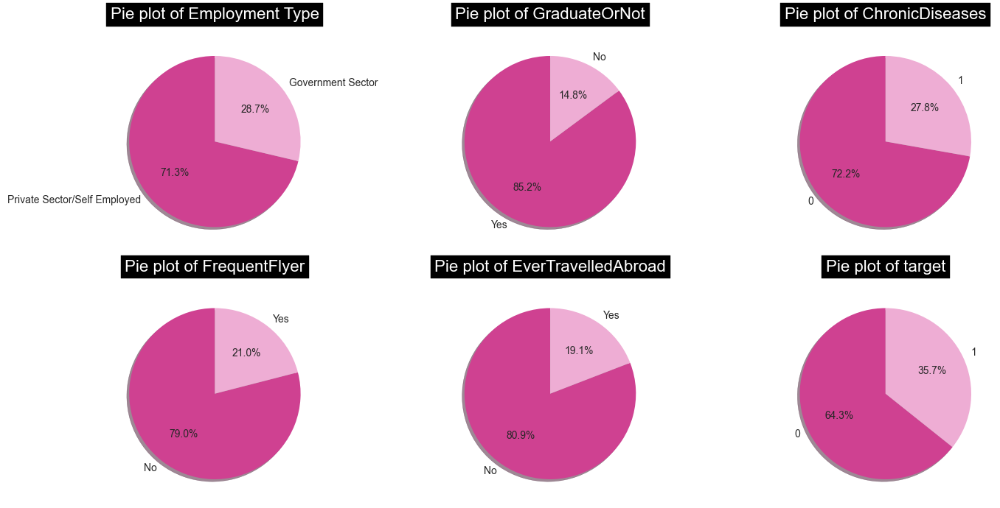

In [10]:
utils.custom_pieplot(df=cat_df, ncols=3, figsize=(15, 7), color=color)

> Insight: Looking at the Travel Insurance (target) chart, the number of people who do not buy insurance is higher (64.3%). However, in reality, this ratio is balanced and there is no big difference.

<br>

<h3 align='center'>
<span style='background:palegreen; color:grey'>
<b>
2.3 | Visualize Numeric data
</b>
</span>
</h3>

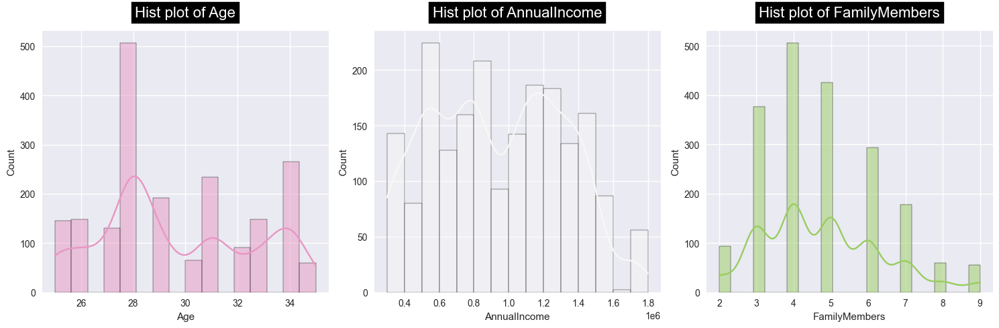

In [11]:
utils.custom_histplot(df=num_df, ncols=3, figsize=(15, 5), color=color )

<br>

Now let's draw box plot to detect outliers in numerical data.

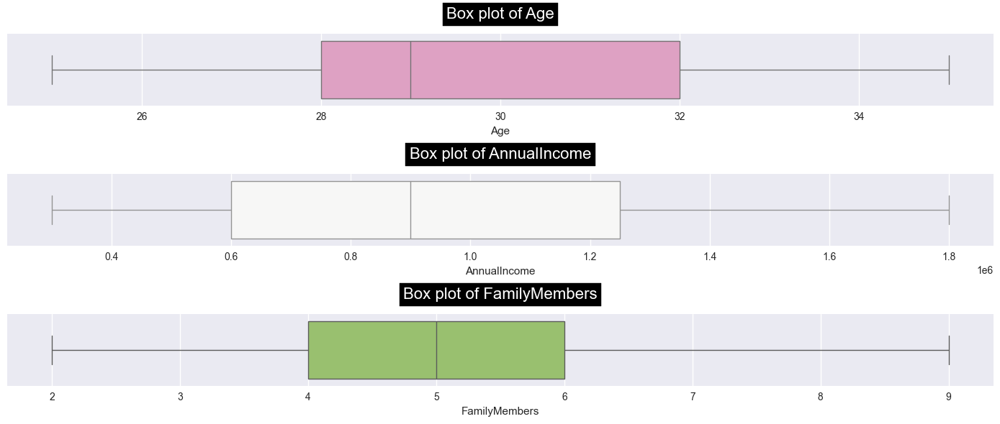

In [12]:
utils.custom_boxplot(df=num_df, ncols=1, color=color)

> Insight: Because except for the excessive duplicate values ​​mentioned above, the data does not have any other errors, nor outliers, so the preprocessing step is only used to handle them.

<br>

<h2 align='center'>
<span style='background:black; color:lawngreen'>
<b>
3 | Data Preprocessing
</b>
</span>
</h2>

In [13]:
def preprocessing_data(df):
    '''
      Preprocess your data (eg. Drop null datapoints or fill missing data)
      :param df: pandas DataFrame
      :return: pandas DataFrame
    '''
    df['AnnualIncome'] = df['AnnualIncome'].apply(utils.add_noise)
    return df

In [14]:
processed_df = preprocessing_data(df.copy())
processed_df.duplicated().sum()

np.int64(0)

<br>

<h2 align='center'>
<span style='background:black; color:lawngreen'>
<b>
4 | Feature Engineering
</b>
</span>
</h2>

In [15]:
def apply_feature_engineering(
    df: pd.DataFrame, cat_df: pd.DataFrame, drop_col: str
) -> None:
    '''
    Apply all feature engineering to transform your data into number
    :param df: pandas DataFrame
    :return: pandas DataFrame
    '''
    for col in cat_df.columns:
        df[col] = df[col].astype('category').cat.codes
    return df

fe_df = apply_feature_engineering(
    df=processed_df.copy(), cat_df=cat_df, drop_col='target'
)

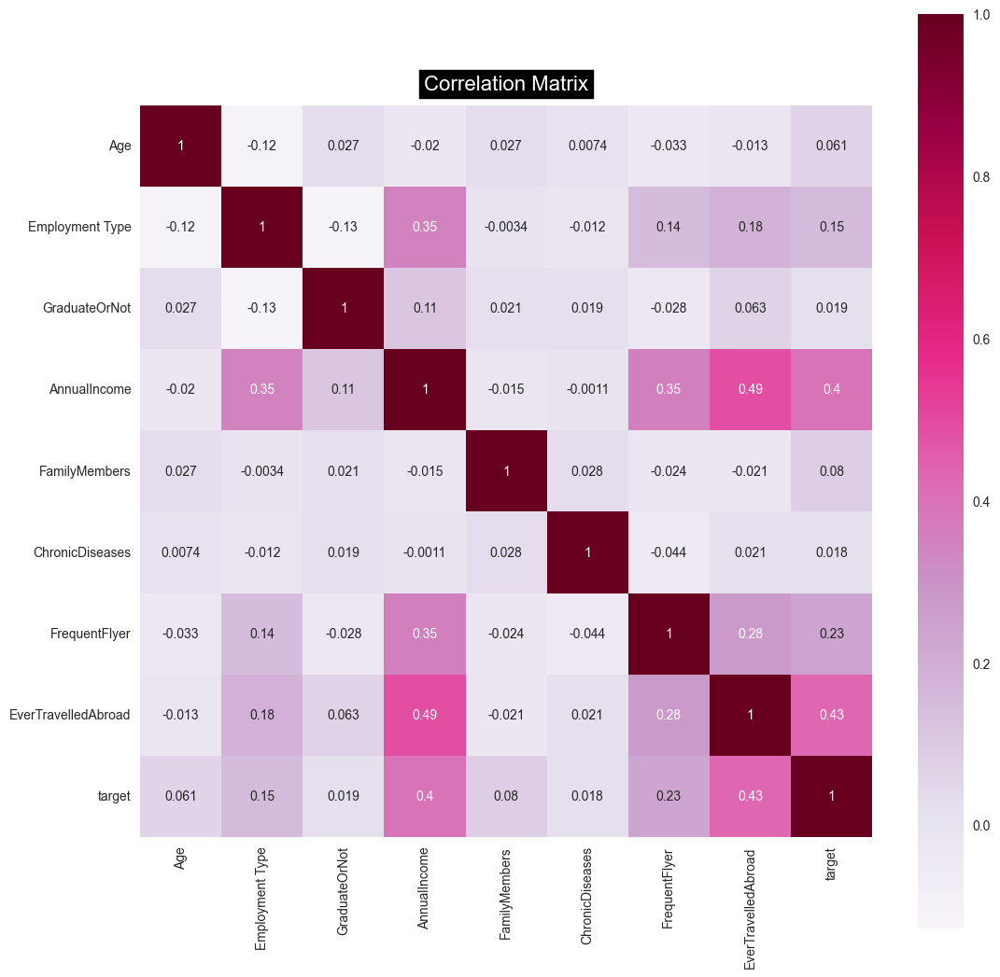

In [16]:
utils.custom_heatmap(df=fe_df, figsize=(10, 10), color='PuRd')

<br>

Prepare data for train-test split step:

In [17]:
X, y = utils.prepare_x_y(df=fe_df, target='target')
print(f'X shape: {X.shape}\nY shape: {y.shape}')

X shape: (1987, 8)
Y shape: (1987, 1)


<Axes: xlabel='target', ylabel='count'>

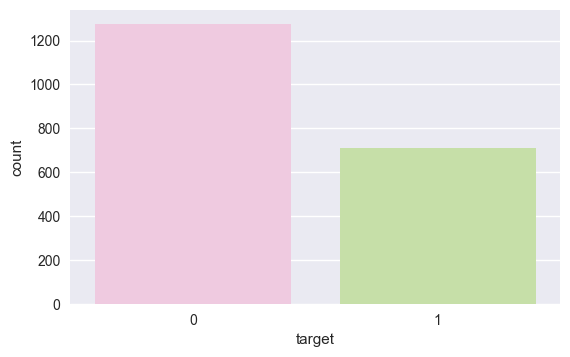

In [18]:
plt.figure(figsize=(5, 3))
sns.countplot(x=df['target'], palette=color)

<br>

<h2 align='center'>
<span style='background:black; color:lawngreen'>
<b>
5 | Split data
</b>
</h2>

In [19]:
from sklearn.model_selection import train_test_split

RANDOM_STATE = 24
TRAIN_SIZE = 0.8

trainX, testX ,trainY, testY = train_test_split(
    X, y, train_size=TRAIN_SIZE, random_state=RANDOM_STATE, shuffle=True
)
print(f'Train X shape: {trainX.shape}')
print(f'Train y shape: {trainY.shape}')
print(f'Test X shape: {testX.shape}')
print(f'Test y shape: {testY.shape}')

Train X shape: (1589, 8)
Train y shape: (1589, 1)
Test X shape: (398, 8)
Test y shape: (398, 1)


<br>

<h2 align='center'>
<span style='background:black; color:lawngreen'>
<b>
6 | Handling Imbalanced Data
</b>
</h2>

In [20]:
def display_after_handling(handling_method_y: np.array) -> None:
    print('Original dataset shape:', y.shape)
    print('Resample dataset shape', handling_method_y.shape)

    plt.figure(figsize=(5, 3))
    sns.countplot(x=handling_method_y, palette=color)

<br>

<h3 align='center'>
<span style='background:palegreen; color:grey'>
<b>
6.1 | Undersampling
</b>
</h3>

Original dataset shape: (1987, 1)
Resample dataset shape (1420,)


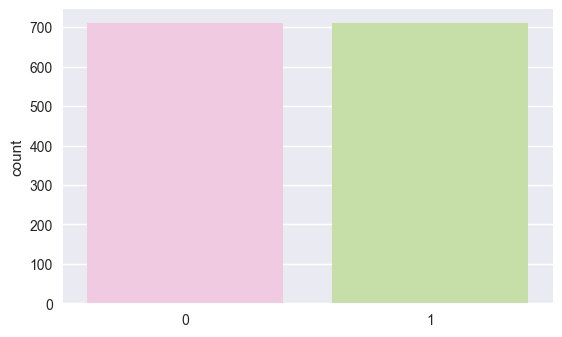

In [21]:
from imblearn.under_sampling import RandomUnderSampler

# fit predictor and target variable
rus = RandomUnderSampler(random_state=42, replacement=True)
rus_X, rus_y = rus.fit_resample(X, y)
display_after_handling(rus_y)

rus_trainX, rus_testX, rus_trainY, rus_testY = train_test_split(
    rus_X, rus_y, train_size=TRAIN_SIZE, random_state=RANDOM_STATE, shuffle=True
)

<br>

<h3 align='center'>
<span style='background:palegreen; color:grey'>
<b>
6.2 | Oversampling
</b>
</h3>

Original dataset shape: (1987, 1)
Resample dataset shape (2554,)


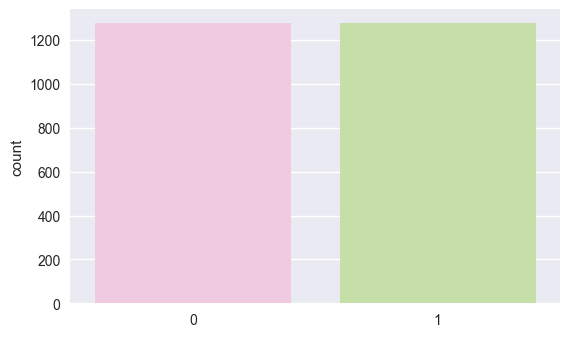

In [22]:
from imblearn.over_sampling import SMOTE

smote = SMOTE()
smote_X, smote_y = smote.fit_resample(X, y)
display_after_handling(smote_y)

smote_trainX, smote_testX, smote_trainY, smote_testY = train_test_split(
    smote_X, smote_y, train_size=TRAIN_SIZE, random_state=RANDOM_STATE, shuffle=True
)

<br>

<h3 align='center'>
<span style='background:palegreen; color:grey'>
<b>
6.3 | SMOTEENN
</b>
</h3>

Original dataset shape: (1987, 1)
Resample dataset shape (1430,)


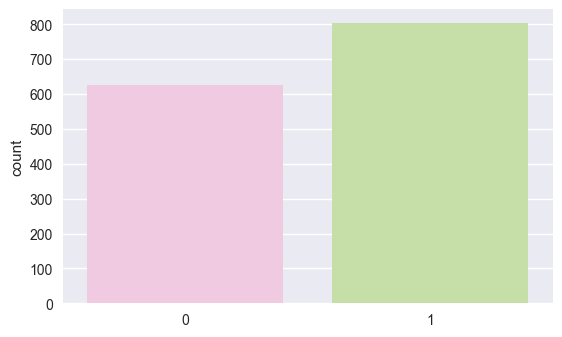

In [23]:
from imblearn.combine import SMOTEENN
sm = SMOTEENN()
sm_X, sm_y = sm.fit_resample(X, y)
display_after_handling(sm_y)

sm_trainX, sm_testX, sm_trainY, sm_testY = train_test_split(
    sm_X, sm_y, train_size=TRAIN_SIZE, random_state=RANDOM_STATE, shuffle=True
)

In [24]:
data = {
    'og': [trainX, trainY, testX, testY],
    'rus': [rus_trainX, rus_trainY, rus_testX, rus_testY],
    'smote': [smote_trainX, smote_trainY, smote_testX, smote_testY],
    'sm': [sm_trainX, sm_trainY, sm_testX, sm_testY]
}
names = ['Original', 'Random UnderSampling','Smote','Smoteen']

<br>

<h2 align='center'>
<span style='background:black; color:lawngreen'>
<b>
7 | Naive Bayes model
</b>
</h2>

In [25]:
from sklearn.preprocessing import MinMaxScaler
from sklearn.pipeline import Pipeline
from sklearn.decomposition import PCA
from sklearn.model_selection import GridSearchCV
from sklearn.naive_bayes import GaussianNB, BernoulliNB
from sklearn.base import ClassifierMixin
from typing import Dict, Any

<br>

Build the function to choose best parameter to build our model:

In [33]:
def tune_model(
    model: ClassifierMixin,
    param_grid: Dict[str, list],
    X_train: np.array,
    y_train: np.array,
    cv: int = 5,
    scoring: str = 'recall_weighted',
) -> Dict[str, Any]:
    '''
        Find the best params for your model above (including your best params)
        :param model: the model you have design
        :return: a model with best params
    '''
    grid_search = GridSearchCV(
        estimator=model,
        param_grid=param_grid,
        cv=cv,
        scoring=scoring,
        n_jobs=-1,
        verbose=1
    )
    grid_search.fit(X_train, y_train)
    return grid_search

<br>

<h3 align='center'>
<span style='background:palegreen; color:grey'>
<b>
7.1 | Gaussian NB
</b>
</span>
</h3>

In [34]:
def model_gaunb(
    dataset_name: str,
    X_train: np.array,
    y_train: np.array,
    X_test: np.array,
    y_test: np.array
) -> None:
    '''
    Design your model and train it (including your best params)
    :param X: feature matrix
    :param y: target
    :return: a model
    '''
    pipe = Pipeline(steps=[
        ('scaler', MinMaxScaler()),
        ('pca', PCA()),
        ('gau_nb', GaussianNB())
    ])

    param_grid = {
        'scaler__feature_range': [(-1, 1), (0, 1)],
        'pca__n_components': [2, 5, 10],
        'gau_nb__var_smoothing': np.logspace(-4, -9, num=100)
    }
    
    model = tune_model(
        model=pipe, param_grid=param_grid, X_train=X_train, y_train=y_train, cv=10
    )
    y_pred = model.predict(X_test)

    show = utils.display_model_metric(y_test, y_pred, dataset_name)

    return show

In [35]:
show_gau = []
for i, key in enumerate(data.keys()):
    show_gau.extend(
        model_gaunb(
            dataset_name=names[i],
            X_train=data[key][0],
            y_train=data[key][1],
            X_test=data[key][2],
            y_test=data[key][3]
        )
    )

Fitting 10 folds for each of 600 candidates, totalling 6000 fits


/Users/trantrieunghi/Desktop/NMMH/Lab/.venv/lib/python3.13/site-packages/sklearn/decomposition/_pca.py:606: RuntimeWarning: divide by zero encountered in matmul
  C = X.T @ X
/Users/trantrieunghi/Desktop/NMMH/Lab/.venv/lib/python3.13/site-packages/sklearn/decomposition/_pca.py:606: RuntimeWarning: overflow encountered in matmul
  C = X.T @ X
/Users/trantrieunghi/Desktop/NMMH/Lab/.venv/lib/python3.13/site-packages/sklearn/decomposition/_pca.py:606: RuntimeWarning: invalid value encountered in matmul
  C = X.T @ X
/Users/trantrieunghi/Desktop/NMMH/Lab/.venv/lib/python3.13/site-packages/sklearn/decomposition/_base.py:148: RuntimeWarning: divide by zero encountered in matmul
  X_transformed = X @ self.components_.T
/Users/trantrieunghi/Desktop/NMMH/Lab/.venv/lib/python3.13/site-packages/sklearn/decomposition/_base.py:148: RuntimeWarning: overflow encountered in matmul
  X_transformed = X @ self.components_.T
/Users/trantrieunghi/Desktop/NMMH/Lab/.venv/lib/python3.13/site-packages/sklearn/d

Fitting 10 folds for each of 600 candidates, totalling 6000 fits


/Users/trantrieunghi/Desktop/NMMH/Lab/.venv/lib/python3.13/site-packages/sklearn/decomposition/_pca.py:606: RuntimeWarning: divide by zero encountered in matmul
  C = X.T @ X
/Users/trantrieunghi/Desktop/NMMH/Lab/.venv/lib/python3.13/site-packages/sklearn/decomposition/_pca.py:606: RuntimeWarning: overflow encountered in matmul
  C = X.T @ X
/Users/trantrieunghi/Desktop/NMMH/Lab/.venv/lib/python3.13/site-packages/sklearn/decomposition/_pca.py:606: RuntimeWarning: invalid value encountered in matmul
  C = X.T @ X
/Users/trantrieunghi/Desktop/NMMH/Lab/.venv/lib/python3.13/site-packages/sklearn/decomposition/_base.py:148: RuntimeWarning: divide by zero encountered in matmul
  X_transformed = X @ self.components_.T
/Users/trantrieunghi/Desktop/NMMH/Lab/.venv/lib/python3.13/site-packages/sklearn/decomposition/_base.py:148: RuntimeWarning: overflow encountered in matmul
  X_transformed = X @ self.components_.T
/Users/trantrieunghi/Desktop/NMMH/Lab/.venv/lib/python3.13/site-packages/sklearn/d

Fitting 10 folds for each of 600 candidates, totalling 6000 fits


ab/.venv/lib/python3.13/site-packages/sklearn/decomposition/_base.py:148: RuntimeWarning: divide by zero encountered in matmul
  X_transformed = X @ self.components_.T
/Users/trantrieunghi/Desktop/NMMH/Lab/.venv/lib/python3.13/site-packages/sklearn/decomposition/_base.py:148: RuntimeWarning: overflow encountered in matmul
  X_transformed = X @ self.components_.T
/Users/trantrieunghi/Desktop/NMMH/Lab/.venv/lib/python3.13/site-packages/sklearn/decomposition/_base.py:148: RuntimeWarning: invalid value encountered in matmul
  X_transformed = X @ self.components_.T
/Users/trantrieunghi/Desktop/NMMH/Lab/.venv/lib/python3.13/site-packages/sklearn/decomposition/_base.py:148: RuntimeWarning: divide by zero encountered in matmul
  X_transformed = X @ self.components_.T
/Users/trantrieunghi/Desktop/NMMH/Lab/.venv/lib/python3.13/site-packages/sklearn/decomposition/_base.py:148: RuntimeWarning: overflow encountered in matmul
  X_transformed = X @ self.components_.T
/Users/trantrieunghi/Desktop/NMMH

Fitting 10 folds for each of 600 candidates, totalling 6000 fits


/Users/trantrieunghi/Desktop/NMMH/Lab/.venv/lib/python3.13/site-packages/sklearn/decomposition/_pca.py:606: RuntimeWarning: divide by zero encountered in matmul
  C = X.T @ X
/Users/trantrieunghi/Desktop/NMMH/Lab/.venv/lib/python3.13/site-packages/sklearn/decomposition/_pca.py:606: RuntimeWarning: overflow encountered in matmul
  C = X.T @ X
/Users/trantrieunghi/Desktop/NMMH/Lab/.venv/lib/python3.13/site-packages/sklearn/decomposition/_pca.py:606: RuntimeWarning: invalid value encountered in matmul
  C = X.T @ X
/Users/trantrieunghi/Desktop/NMMH/Lab/.venv/lib/python3.13/site-packages/sklearn/decomposition/_base.py:148: RuntimeWarning: divide by zero encountered in matmul
  X_transformed = X @ self.components_.T
/Users/trantrieunghi/Desktop/NMMH/Lab/.venv/lib/python3.13/site-packages/sklearn/decomposition/_base.py:148: RuntimeWarning: overflow encountered in matmul
  X_transformed = X @ self.components_.T
/Users/trantrieunghi/Desktop/NMMH/Lab/.venv/lib/python3.13/site-packages/sklearn/d

In [56]:
from tabulate import tabulate
headers = ['Sampling Technique', 'Accuracy', 'Precision', 'Recall', 'F1']
print('Model: GaussianNB\n')
print(tabulate(
    show_gau,
    headers=headers,
))

Model: GaussianNB

Sampling Technique      Accuracy    Precision    Recall    F1
--------------------  ----------  -----------  --------  ----
Original                    0.76         0.72      0.53  0.61
Random UnderSampling        0.71         0.85      0.49  0.62
Smote                       0.7          0.78      0.52  0.62
Smoteen                     0.75         0.82      0.71  0.76


<br>

<h3 align='center'>
<span style='background:palegreen; color:grey'>
<b>
7.2 | Bernoulli NB
</b>
</span>
</h3>

In [37]:
def model_bernb(
    dataset_name: str,
    X_train: np.array,
    y_train: np.array,
    X_test: np.array,
    y_test: np.array
) -> None:
    '''
    Design your model and train it (including your best params)
    :param X: feature matrix
    :param y: target
    :return: a model
    '''
    pipe = Pipeline(steps=[
        ('pca', PCA()),
        ('ber_nb', BernoulliNB())
    ])
    param_grid = {
        'pca__n_components': [2, 5, 10],
        'ber_nb__alpha': np.logspace(-1, -9, num=100),
        'ber_nb__fit_prior': [True, False]
    }
    model = tune_model(
        model=pipe, param_grid=param_grid, X_train=X_train, y_train=y_train, cv=8
    )
    y_pred = model.predict(X_test)

    show = utils.display_model_metric(y_test, y_pred, dataset_name)
    return show

In [38]:
show_ber = []
for i, key in enumerate(data.keys()):
    show_ber.extend(
        model_bernb(
            dataset_name=names[i],
            X_train=data[key][0],
            y_train=data[key][1],
            X_test=data[key][2],
            y_test=data[key][3]
        )
    )

Fitting 8 folds for each of 600 candidates, totalling 4800 fits


/Users/trantrieunghi/Desktop/NMMH/Lab/.venv/lib/python3.13/site-packages/sklearn/decomposition/_pca.py:606: RuntimeWarning: divide by zero encountered in matmul
  C = X.T @ X
/Users/trantrieunghi/Desktop/NMMH/Lab/.venv/lib/python3.13/site-packages/sklearn/decomposition/_pca.py:606: RuntimeWarning: overflow encountered in matmul
  C = X.T @ X
/Users/trantrieunghi/Desktop/NMMH/Lab/.venv/lib/python3.13/site-packages/sklearn/decomposition/_pca.py:606: RuntimeWarning: invalid value encountered in matmul
  C = X.T @ X
/Users/trantrieunghi/Desktop/NMMH/Lab/.venv/lib/python3.13/site-packages/sklearn/decomposition/_base.py:148: RuntimeWarning: divide by zero encountered in matmul
  X_transformed = X @ self.components_.T
/Users/trantrieunghi/Desktop/NMMH/Lab/.venv/lib/python3.13/site-packages/sklearn/decomposition/_base.py:148: RuntimeWarning: overflow encountered in matmul
  X_transformed = X @ self.components_.T
/Users/trantrieunghi/Desktop/NMMH/Lab/.venv/lib/python3.13/site-packages/sklearn/d

Fitting 8 folds for each of 600 candidates, totalling 4800 fits


/Users/trantrieunghi/Desktop/NMMH/Lab/.venv/lib/python3.13/site-packages/sklearn/decomposition/_pca.py:606: RuntimeWarning: overflow encountered in matmul
  C = X.T @ X
/Users/trantrieunghi/Desktop/NMMH/Lab/.venv/lib/python3.13/site-packages/sklearn/decomposition/_pca.py:606: RuntimeWarning: invalid value encountered in matmul
  C = X.T @ X
/Users/trantrieunghi/Desktop/NMMH/Lab/.venv/lib/python3.13/site-packages/sklearn/decomposition/_base.py:148: RuntimeWarning: divide by zero encountered in matmul
  X_transformed = X @ self.components_.T
/Users/trantrieunghi/Desktop/NMMH/Lab/.venv/lib/python3.13/site-packages/sklearn/decomposition/_base.py:148: RuntimeWarning: overflow encountered in matmul
  X_transformed = X @ self.components_.T
/Users/trantrieunghi/Desktop/NMMH/Lab/.venv/lib/python3.13/site-packages/sklearn/decomposition/_base.py:148: RuntimeWarning: invalid value encountered in matmul
  X_transformed = X @ self.components_.T
/Users/trantrieunghi/Desktop/NMMH/Lab/.venv/lib/python3

Fitting 8 folds for each of 600 candidates, totalling 4800 fits


.components_.T
/Users/trantrieunghi/Desktop/NMMH/Lab/.venv/lib/python3.13/site-packages/sklearn/decomposition/_base.py:148: RuntimeWarning: overflow encountered in matmul
  X_transformed = X @ self.components_.T
/Users/trantrieunghi/Desktop/NMMH/Lab/.venv/lib/python3.13/site-packages/sklearn/decomposition/_base.py:148: RuntimeWarning: invalid value encountered in matmul
  X_transformed = X @ self.components_.T
/Users/trantrieunghi/Desktop/NMMH/Lab/.venv/lib/python3.13/site-packages/sklearn/decomposition/_base.py:148: RuntimeWarning: divide by zero encountered in matmul
  X_transformed = X @ self.components_.T
/Users/trantrieunghi/Desktop/NMMH/Lab/.venv/lib/python3.13/site-packages/sklearn/decomposition/_base.py:148: RuntimeWarning: overflow encountered in matmul
  X_transformed = X @ self.components_.T
/Users/trantrieunghi/Desktop/NMMH/Lab/.venv/lib/python3.13/site-packages/sklearn/decomposition/_base.py:148: RuntimeWarning: invalid value encountered in matmul
  X_transformed = X @ sel

Fitting 8 folds for each of 600 candidates, totalling 4800 fits


/Users/trantrieunghi/Desktop/NMMH/Lab/.venv/lib/python3.13/site-packages/sklearn/decomposition/_base.py:148: RuntimeWarning: divide by zero encountered in matmul
  X_transformed = X @ self.components_.T
/Users/trantrieunghi/Desktop/NMMH/Lab/.venv/lib/python3.13/site-packages/sklearn/decomposition/_base.py:148: RuntimeWarning: overflow encountered in matmul
  X_transformed = X @ self.components_.T
/Users/trantrieunghi/Desktop/NMMH/Lab/.venv/lib/python3.13/site-packages/sklearn/decomposition/_base.py:148: RuntimeWarning: invalid value encountered in matmul
  X_transformed = X @ self.components_.T
/Users/trantrieunghi/Desktop/NMMH/Lab/.venv/lib/python3.13/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/trantrieunghi/Desktop/NMMH/Lab/.venv/lib/python3.13/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/trantrieunghi/Desktop/NMMH/Lab/.venv/lib/python3.13/site-

In [39]:
print('Model: BernoulliNB\n')
print(tabulate(
    show_ber,
    headers=headers,
))

Model: BernoulliNB

Sampling Technique      Accuracy    Precision    Recall    F1
--------------------  ----------  -----------  --------  ----
Original                    0.7          0.64      0.38  0.48
Random UnderSampling        0.65         0.63      0.67  0.65
Smote                       0.65         0.62      0.71  0.66
Smoteen                     0.77         0.79      0.81  0.8


<div class='alert alert-success' role='alert'>

In both Naive Bayes models, the results when training on the **Smoteen** data seem to be the best.

</div>

<br>

<h2 align='center'>
<span style='background:black; color:lawngreen'>
<b>
8 | Decision Tree model
</b>
</h2>

| Name                | Meaning                                                                 |
|---------------------|------------------------------------------------------------------------|
| `criterion`         | Function used to evaluate the quality of the split.                             |
| `max_depth`         | Limit the maximum depth of the tree (`None` = unlimited).              |
| `min_samples_split` | Minimum number of samples for a node to be split.                          |
| `min_samples_leaf`  | Minimum number of samples at a leaf node.                                        |
| `max_features`      | Maximum number of features to use when finding best split. `'sqrt'` is often used for classification. |
| `class_weight`      | Allows rebalancing of class-skewed data (useful for imbalanced dataset). |

In [42]:
from sklearn.tree import DecisionTreeClassifier

def model_decision_tree(
    dataset_name: str,
    X_train: np.array,
    y_train: np.array,
    X_test: np.array,
    y_test: np.array
) -> ClassifierMixin:
    '''
    Build Decision Tree model
    '''
    pipe = Pipeline(steps=[('tree', DecisionTreeClassifier())])
    param_grid = {
        'tree__criterion': ['gini', 'entropy', 'log_loss'],
        'tree__max_depth': [None, 5, 10, 20],  # to avoid overfitting
        'tree__min_samples_split': [2, 5, 10],
        'tree__min_samples_leaf': [1, 2, 4],
        'tree__max_features': [None, 'sqrt', 'log2'],
        'tree__class_weight': [None, 'balanced'],
    }
    model = tune_model(
        model=pipe, param_grid=param_grid, X_train=X_train, y_train=y_train
    )
    y_pred = model.predict(X_test)

    show = utils.display_model_metric(y_test, y_pred, dataset_name)
    return show

In [43]:
show_decision_tree = []
for i, key in enumerate(data.keys()):
    show_decision_tree.extend(
        model_decision_tree(
            dataset_name=names[i],
            X_train=data[key][0],
            y_train=data[key][1],
            X_test=data[key][2],
            y_test=data[key][3]
        )
    )

Fitting 5 folds for each of 648 candidates, totalling 3240 fits
Fitting 5 folds for each of 648 candidates, totalling 3240 fits
Fitting 5 folds for each of 648 candidates, totalling 3240 fits
Fitting 5 folds for each of 648 candidates, totalling 3240 fits


In [44]:
print('Model: Decision Tree\n')
print(tabulate(
    show_decision_tree,
    headers=headers,
))

Model: Decision Tree

Sampling Technique      Accuracy    Precision    Recall    F1
--------------------  ----------  -----------  --------  ----
Original                    0.85         0.95      0.61  0.74
Random UnderSampling        0.74         0.9       0.53  0.67
Smote                       0.79         0.84      0.7   0.76
Smoteen                     0.98         0.98      0.98  0.98


<div class='alert alert-success' role='alert'>

The result when training on the **Smoteen** data still seem to be the best.

</div>

<br>

<h2 align='center'>
<span style='background:black; color:lawngreen'>
<b>
9 | Random Forest model
</b>
</h2>

In [53]:
from sklearn.ensemble import RandomForestClassifier

def model_random_forest(
    dataset_name: str,
    X_train: np.array,
    y_train: np.array,
    X_test: np.array,
    y_test: np.array
) -> ClassifierMixin:
    pipe = Pipeline(
        steps=['rf', RandomForestClassifier()]
    )
    param_grid = {
        'rf__n_estimators': [20, 50, 100, 200],  # numbers of tree
    }
    model = tune_model(
        model=pipe, param_grid=param_grid, X_train=X_train, y_train=y_train, cv=8
    )
    y_pred = model.predict(X_test)
    
    show = utils.display_model_metric(y_test, y_pred, dataset_name)
    return show

In [54]:
show_random_forest = []
for i, key in enumerate(data.keys()):
    show_random_forest.extend(
        model_decision_tree(
            dataset_name=names[i],
            X_train=data[key][0],
            y_train=data[key][1],
            X_test=data[key][2],
            y_test=data[key][3]
        )
    )

Fitting 5 folds for each of 648 candidates, totalling 3240 fits
Fitting 5 folds for each of 648 candidates, totalling 3240 fits
Fitting 5 folds for each of 648 candidates, totalling 3240 fits
Fitting 5 folds for each of 648 candidates, totalling 3240 fits


In [61]:
print('Model: Random Forest\n')
print(tabulate(
    show_random_forest,
    headers=headers,
))

Model: Random Forest

Sampling Technique      Accuracy    Precision    Recall    F1
--------------------  ----------  -----------  --------  ----
Original                    0.85         0.93      0.61  0.74
Random UnderSampling        0.77         0.95      0.57  0.71
Smote                       0.81         0.83      0.76  0.79
Smoteen                     0.97         0.97      0.98  0.98


<div class='alert alert-success' role='alert'>

The result when training on the **Smoteen** data still seem to be the best.

</div>

<br>

<h2 align='center'>
<span style='background:black; color:lawngreen'>
<b>
10 | Conclusion
</b>
</h2>

In [63]:
print('Model: GaussianNB\n')
print(tabulate(
    show_gau,
    headers=headers,
))
print('\n')

print('Model: BernoulliNB\n')
print(tabulate(
    show_ber,
    headers=headers,
))
print('\n')


Model: GaussianNB

Sampling Technique      Accuracy    Precision    Recall    F1
--------------------  ----------  -----------  --------  ----
Original                    0.76         0.72      0.53  0.61
Random UnderSampling        0.71         0.85      0.49  0.62
Smote                       0.7          0.78      0.52  0.62
Smoteen                     0.75         0.82      0.71  0.76


Model: BernoulliNB

Sampling Technique      Accuracy    Precision    Recall    F1
--------------------  ----------  -----------  --------  ----
Original                    0.7          0.64      0.38  0.48
Random UnderSampling        0.65         0.63      0.67  0.65
Smote                       0.65         0.62      0.71  0.66
Smoteen                     0.77         0.79      0.81  0.8




In [64]:
print('Model: Decision Tree\n')
print(tabulate(
    show_decision_tree,
    headers=headers,
))
print('\n')

print('Model: Random Forest\n')
print(tabulate(
    show_random_forest,
    headers=headers,
))

Model: Decision Tree

Sampling Technique      Accuracy    Precision    Recall    F1
--------------------  ----------  -----------  --------  ----
Original                    0.85         0.95      0.61  0.74
Random UnderSampling        0.74         0.9       0.53  0.67
Smote                       0.79         0.84      0.7   0.76
Smoteen                     0.98         0.98      0.98  0.98


Model: Random Forest

Sampling Technique      Accuracy    Precision    Recall    F1
--------------------  ----------  -----------  --------  ----
Original                    0.85         0.93      0.61  0.74
Random UnderSampling        0.77         0.95      0.57  0.71
Smote                       0.81         0.83      0.76  0.79
Smoteen                     0.97         0.97      0.98  0.98


<div class='alert alert-success' role='alert'>

Overall, the results when training on the **Smoteen** data in all model seem to be the best. However, the performance of Decision Tree and Random Forest is more stable and better than Naive Bayes models.

</div>